Animation size has reached 20996905 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


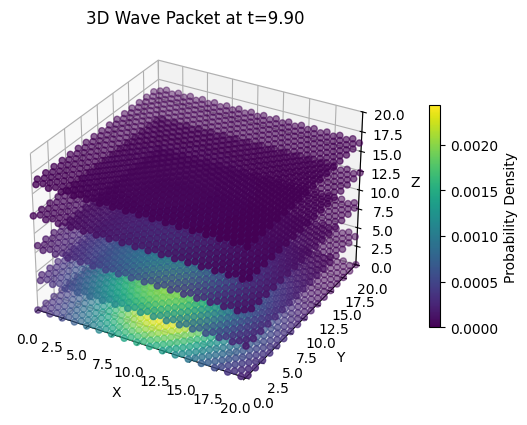

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D
from IPython.display import HTML

# Constants (in arbitrary units)
hbar = 1.0
m = 1.0

# Spatial grid
N = 50  # grid points per dimension
x = np.linspace(0, 20, N)
y = np.linspace(0, 20, N)
z = np.linspace(0, 20, N)
X, Y, Z = np.meshgrid(x, y, z)

# Initial wave packet parameters
sigma0 = 1.0         # initial width
k0 = np.array([1.0, 0.0, 0.0])  # initial momentum along x
r0 = np.array([0.0, 5.0, 1.0])  # initial position

def psi_3d_gauss(x, y, z, t):
    # Time-dependent width (free particle spreading)
    sigma_t = sigma0 * np.sqrt(1 + (hbar * t / (2 * m * sigma0**2))**2)
    
    # Time-dependent normalization factor
    norm = (1 / (sigma_t * np.sqrt(2 * np.pi)))**3
    
    # Displacement from center
    Xc = x - r0[0] - (hbar * k0[0] / m) * t
    Yc = y - r0[1] - (hbar * k0[1] / m) * t
    Zc = z - r0[2] - (hbar * k0[2] / m) * t
    
    # Gaussian envelope with spreading
    envelope = np.exp(-(Xc**2 + Yc**2 + Zc**2) / (4 * sigma_t**2))
    
    # Phase factor from momentum (plane wave)
    phase = np.exp(1j * (k0[0]*x + k0[1]*y + k0[2]*z - (hbar * np.dot(k0,k0) / (2*m)) * t))
    
    return norm * envelope * phase

# Initialize plot
fig = plt.figure()
ax = fig.add_subplot(projection='3d')
ax.set_xlim(0, 20)
ax.set_ylim(0, 20)
ax.set_zlim(0, 20)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('3D Free Particle Wave Packet Probability Density')

# Initial probability density
psi0 = psi_3d_gauss(X, Y, Z, 0)
prob_density = np.abs(psi0)**2

# Create subsampled indices
idx = np.arange(0, N**3, 30)
x_s = X.flatten()[idx]
y_s = Y.flatten()[idx]
z_s = Z.flatten()[idx]
c_s = prob_density.flatten()[idx]

# Create scatter ONCE, store scatter for colorbar reference
scatter = ax.scatter(x_s, y_s, z_s, c=c_s, cmap='viridis', s=20)

# Add color bar linked to scatter
cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, pad=0.1)
cbar.set_label('Probability Density')

def update(frame):
    t = frame * 0.1
    psi_t = psi_3d_gauss(X, Y, Z, t)
    prob_density_t = np.abs(psi_t)**2
    c_s = prob_density_t.flatten()[idx]
    # Remove old scatter and plot new one
    ax.collections[0].remove()  # Remove the oldest scatter
    scatter_new = ax.scatter(x_s, y_s, z_s, c=c_s, cmap='viridis', s=20)
    ax.set_title(f'3D Wave Packet at t={t:.2f}')
    return scatter_new,

ani = FuncAnimation(fig, update, frames=100, interval=100, blit=False)
HTML(ani.to_jshtml())
